<p style="background-color:steelblue;font-family:newtimeroman;font-size:200%;color:white;text-align:center;border-radius:20px 20px;"><b>Online Retail Project - RFM & Cohort Analysis</b></p>

<div style="text-align: center;">
    <img src="https://miro.medium.com/v2/resize:fit:922/1*IviHioB4RphuX6WEw_hONg.jpeg" width="650" height="650"/>
</div>

<b>Contains:</b>
<ul>
<li><a href="#import-library">Importing Libraries</a></li>
<li><a href="#loading-dataset">Loading The Dataset</a></li>
<li><a href="#eda">Understanding Data & EDA</a></li>
<li><a href="#rfm">RFM Analysis</a></li>
<li><a href="#cohort">Cohort Analysis</a></li>
<li><a href="#conclusion">Conclusion</a></li>
</ul>

# <font color='steelblue'> <b>Introduction</b><font color='black'>  

This project is focused on **RFM analysis and customer segmentation**. Customer behavior is analyzed, and personalized strategies are developed, which are crucial in the online retail sector. By using **Recency, Frequency, and Monetary (RFM) metrics**, customers are categorized into different segments, and targeted marketing strategies are defined accordingly.

In this study, the Online Retail dataset was used to segment customers into **Bronze, Silver, Gold, and VIP categories**. Additionally, **unsupervised machine learning clustering techniques** were applied to gain deeper insights into customer groups. Through this analysis, customer loyalty can be enhanced, and more effective marketing campaigns can be executed by businesses.

<a id='import-library'></a>
# <font color='steelblue'> <b>Importing Libraries</b><font color='black'> 

In [39]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from skimpy import skim

from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder, OrdinalEncoder
from sklearn.metrics import silhouette_score
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.cluster import KMeans, AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.cluster import SilhouetteVisualizer

import warnings
warnings.filterwarnings('ignore')

<a id='loading-dataset'></a>
# <font color='steelblue'> <b>Loading The Dataset</b><font color='black'> 

**About Dataset:**
   
- **InvoiceNo**: Invoice number (6 digits, unique for each transaction).  
- **StockCode**: Product or stock code (5 digits, unique for each product).  
- **Description**: Product description.  
- **Quantity**: Quantity of products sold.  
- **InvoiceDate**: Invoice date and time.  
- **UnitPrice**: Unit price of the product (in GBP).  
- **CustomerID**: Customer number (5 digits).  
- **Country**: Country where the customer iscated.  


In [42]:
df0 = pd.read_excel("Online Retail.xlsx")
df = df0.copy()

In [43]:
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom


In [44]:
df.sample(5)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
182908,552624,22495,SET OF 2 ROUND TINS CAMEMBERT,1,2011-05-10 12:53:00,2.95,14505.0,United Kingdom
226406,556797,22629,SPACEBOY LUNCH BOX,12,2011-06-14 14:49:00,1.95,17101.0,United Kingdom
528610,580729,23401,RUSTIC MIRROR WITH LACE HEART,1,2011-12-05 17:24:00,12.46,NaN,United Kingdom
399519,571281,22476,EMPIRE UNION JACK TV DINNER TRAY,21,2011-10-16 13:23:00,4.25,14088.0,United Kingdom
216387,555845,21260,FIRST AID TIN,2,2011-06-07 13:19:00,3.25,17015.0,United Kingdom


<a id='eda'></a>
# <font color='steelblue'> <b>Understanding Data & Exploratory Data Analysis (EDA)</b><font color='black'> 

In [46]:
df.shape

(541909, 8)

In [47]:
df.duplicated().sum()

5268

In [48]:
df.drop_duplicates(inplace=True)

In [49]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 536641 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   InvoiceNo    536641 non-null  object        
 1   StockCode    536641 non-null  object        
 2   Description  535187 non-null  object        
 3   Quantity     536641 non-null  int64         
 4   InvoiceDate  536641 non-null  datetime64[ns]
 5   UnitPrice    536641 non-null  float64       
 6   CustomerID   401604 non-null  float64       
 7   Country      536641 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(1), object(4)
memory usage: 36.8+ MB


In [50]:
df['CustomerID'] = df['CustomerID'].astype(str)
df['InvoiceNo'] = df['InvoiceNo'].astype('category')
df['StockCode'] = df['StockCode'].astype('category')
df['Country'] = df['Country'].astype('category')
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'],format='%d-%m-%Y %H:%M')

In [51]:
df.describe().T

,count,mean,min,25%,50%,75%,max,std
Quantity,536641.0,9.620029,-80995.0,1.0,3.0,10.0,80995.0,219.130156
InvoiceDate,536641,2011-07-04 08:57:06.087421952,2010-12-01 08:26:00,2011-03-28 10:52:00,2011-07-19 14:04:00,2011-10-18 17:05:00,2011-12-09 12:50:00,NaN
UnitPrice,536641.0,4.632656,-11062.06,1.25,2.08,4.13,38970.0,97.233118


There are some negative values in **Quantity** and **UnitPrice** columns. It is not normal to have negative values ​​in the Quantity and UnitPrice columns. Maybe the values ​​were entered as negative values ​​by mistake when actually wanted to enter a positive value. Therefore, let's turn negative values ​​into positive.

In [53]:
print("The total number of negative values in Quantity is:",(df.Quantity<0).sum())
print("The total number of negative values in Price is:",(df.UnitPrice<0).sum())

The total number of negative values in Quantity is: 10587
The total number of negative values in Price is: 2


In [54]:
# Making negative values ​​positive
df['Quantity'] = df['Quantity'].abs()
df['UnitPrice'] = df['UnitPrice'].abs()

In [55]:
print("Total numbers of zeros in Quantity column: ", df[df['Quantity'] == 0].shape[0])
print("Total numbers of zeros in UnitPrice column:", df[df['UnitPrice'] == 0].shape[0])

Total numbers of zeros in Quantity column:  0
Total numbers of zeros in UnitPrice column: 2510


In [56]:
df = df[df['UnitPrice'] != 0]

In [57]:
df.isnull().sum()

InvoiceNo      0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
UnitPrice      0
CustomerID     0
Country        0
dtype: int64

In [58]:
df.shape

(534131, 8)

In [59]:
df.describe(include="object").T

,count,unique,top,freq
Description,534131,4042,WHITE HANGING HEART T-LIGHT HOLDER,2353
CustomerID,534131,4372,nan,132567


In [60]:
skim(df)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types               Categories                                        │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓ ┏━━━━━━━━━━━━━━━━━━━━━━━┓                                │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃ ┃ Categorical Variables ┃                                │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩ ┡━━━━━━━━━━━━━━━━━━━━━━━┩                                │
│ │ Number of rows    │ 534131 │ │ category    │ 3     │ │ InvoiceNo             │                                │
│ │ Number of columns │ 8      │ │ string      │ 2     │ │ StockCode             │                                │
│ └───────────────────┴────────┘ │ int32       │ 1     │ │ Country               │                                │
│                                │ datetime64  │ 1     │ └───────────────────────┘                                │
│                                │ float64     │ 1     │                                                          │
│                                └─────────────┴───────┘                                                          │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━┳━━━━━━┳━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━━┓  │
│ ┃ column_name     ┃ NA   ┃ NA %   ┃ mean    ┃ sd      ┃ p0      ┃ p25    ┃ p50   ┃ p75    ┃ p100   ┃ hist    ┃  │
│ ┡━━━━━━━━━━━━━━━━━╇━━━━━━╇━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━━┩  │
│ │ Quantity        │    0 │      0 │   10.95 │   216.4 │       1 │      1 │     3 │     11 │  81000 │    ▇    │  │
│ │ UnitPrice       │    0 │      0 │   4.737 │   97.46 │   0.001 │   1.25 │   2.1 │   4.13 │  38970 │    ▇    │  │
│ └─────────────────┴──────┴────────┴─────────┴─────────┴─────────┴────────┴───────┴────────┴────────┴─────────┘  │
│                                                    category                                                     │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name                      ┃ NA        ┃ NA %           ┃ ordered               ┃ unique             ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━┩  │
│ │ InvoiceNo                        │         0 │              0 │ False                 │              23798 │  │
│ │ StockCode                        │         0 │              0 │ False                 │               3938 │  │
│ │ Country                          │         0 │              0 │ False                 │                 38 │  │
│ └──────────────────────────────────┴───────────┴────────────────┴───────────────────────┴────────────────────┘  │
│                                                    datetime                                                     │
│ ┏━━━━━━━━━━━━━━━━━━┳━━━━━━┳━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━┓  │
│ ┃ column_name      ┃ NA   ┃ NA %    ┃ first                      ┃ last                       ┃ frequency    ┃  │
│ ┡━━━━━━━━━━━━━━━━━━╇━━━━━━╇━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━┩  │
│ │ InvoiceDate      │    0 │       0 │    2010-12-01 08:26:00     │    2011-12-09 12:50:00     │ None         │  │
│ └──────────────────┴──────┴─────────┴────────────────────────────┴────────────────────────────┴──────────────┘  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name               ┃ NA      ┃ NA %       ┃ w

In [61]:
df['TotalAmount'] = df['Quantity'] * df['UnitPrice']

In [62]:
print("Latest Date:", max(df['InvoiceDate']))
print("First Date: ", min(df['InvoiceDate']))

Latest Date: 2011-12-09 12:50:00
First Date:  2010-12-01 08:26:00


In [63]:
df['DateDiff'] = max(df['InvoiceDate']) - df['InvoiceDate']
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,TotalAmount,DateDiff
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom,15.30,373 days 04:24:00
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,373 days 04:24:00
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom,22.00,373 days 04:24:00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,373 days 04:24:00
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,373 days 04:24:00


In [64]:
# Numerical features
numeric_columns = df.select_dtypes(include=['number']).columns

# Categorical features
categoric_columns = [col for col in df.columns if str(df[col].dtypes) in ["object", "category", "bool"]]

In [65]:
def detect_outliers(df, col_name,tukey=1.5):
    ''' 
    this function detects outliers based on 1.5 time IQR and
    returns the number of lower and uper limit and number of outliers respectively
    '''
    first_quartile = np.percentile(np.array(df[col_name].tolist()), 25)
    third_quartile = np.percentile(np.array(df[col_name].tolist()), 75)
    IQR = third_quartile - first_quartile
                      
    upper_limit = third_quartile+(tukey*IQR)
    lower_limit = first_quartile-(tukey*IQR)
    outlier_count = 0
                      
    for value in df[col_name].tolist():
        if (value < lower_limit) | (value > upper_limit):
            outlier_count +=1
    return lower_limit, upper_limit, outlier_count

In [66]:
threshold = 1.5
out_cols = []

for col in numeric_columns:
    print(
        f"{col}\nlower:{detect_outliers(df, col,threshold)[0]} \nupper:{detect_outliers(df, col,threshold)[1]}\
        \noutlier:{detect_outliers(df, col,threshold)[2]}\n*-*-*-*-*-*-*"
    )
    if detect_outliers(df, col,threshold)[2] > 0 :
        out_cols.append(col)
print(out_cols)  

Quantity
lower:-14.0 
upper:26.0        
outlier:27666
*-*-*-*-*-*-*
UnitPrice
lower:-3.0700000000000003 
upper:8.45        
outlier:39450
*-*-*-*-*-*-*
TotalAmount
lower:-16.800000000000004 
upper:38.400000000000006        
outlier:43786
*-*-*-*-*-*-*
DateDiff
lower:-255 days +11:19:00 
upper:562 days 09:35:00        
outlier:0
*-*-*-*-*-*-*
['Quantity', 'UnitPrice', 'TotalAmount']


In [67]:
# Capping outliers
for col in ['Quantity', 'UnitPrice', 'TotalAmount']:
    lower, upper, _ = detect_outliers(df, col, threshold)
    df[col] = np.clip(df[col], lower, upper)

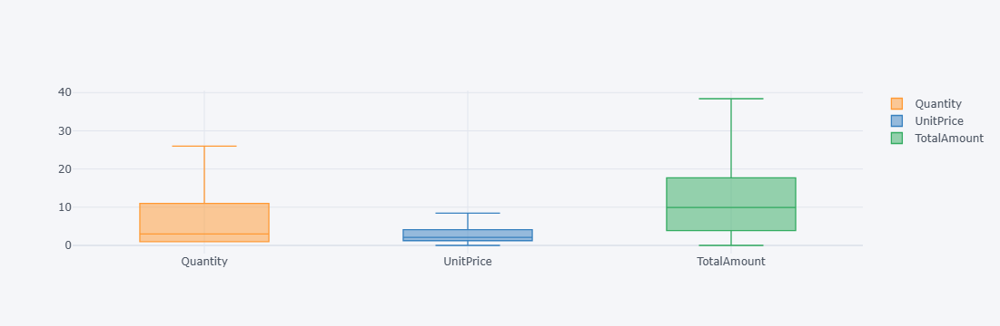

In [68]:
import cufflinks as cf 

cf.go_offline()
df.drop(columns= ['InvoiceNo', 'StockCode', 'Description', 'CustomerID', 'Country', 'InvoiceDate']).iloc[:,:-1].iplot(kind="box")

In [69]:
def cat_summary(dataframe, col_name):

    print(pd.DataFrame({

        col_name: dataframe[col_name].value_counts(),  # Count of unique values

        "Ratio": 100 * dataframe[col_name].value_counts() / len(dataframe)  # Percentage of each unique value

    }))

    print("------------------------------------------------------------------")

In [70]:
for col in categoric_columns:
    cat_summary(df, col)

           InvoiceNo     Ratio
InvoiceNo                     
573585          1114  0.208563
581219           749  0.140228
581492           731  0.136858
580729           721  0.134986
558475           705  0.131990
...              ...       ...
537436             0  0.000000
579272             0  0.000000
545236             0  0.000000
554828             0  0.000000
553728             0  0.000000

[25900 rows x 2 columns]
------------------------------------------------------------------
           StockCode     Ratio
StockCode                     
85123A          2295  0.429670
22423           2187  0.409450
85099B          2153  0.403085
47566           1719  0.321831
20725           1626  0.304420
...              ...       ...
72803B             0  0.000000
84967B             0  0.000000
21474              0  0.000000
72800F             0  0.000000
72814              0  0.000000

[4070 rows x 2 columns]
------------------------------------------------------------------
         

In [71]:
# saving final version of df
df.to_excel("final_data.xlsx", index=False)

<a id='rfm'></a>
# <font color='steelblue'> <b>RFM Analysis</b><font color='black'> 

**What is RFM Analysis?**

RFM analysis is a marketing technique used to evaluate customer behavior.

RFM stands for Recency, Frequency, and Monetary, which are the key components of this analysis.

---

**RFM Components:**

- **Recency:** Indicates how recently a customer has made a purchase. Customers who have made purchases more recently have a higher recency score.  

- **Frequency:** Represents the number of purchases a customer has made within a specific period (typically within a year). Customers who shop more frequently have a higher frequency score.  

- **Monetary:** Refers to the total amount a customer has spent within a given period. Customers who spend more have a higher monetary score.  

---

**How is RFM Analysis Conducted?**

1. **Preparing Customer Data:** Customer data from a relevant period is collected, typically including customer IDs, purchase dates, and transaction amounts.  

2. **Calculating RFM Scores:** Recency, Frequency, and Monetary scores are calculated for each customer. These scores are usually scaled between 1 and 5, where 5 represents the best customers (most recent, frequent, and high-spending), while 1 represents the least engaged customers.  

3. **Customer Segmentation:** Customers are grouped based on their RFM scores. For example, segments like "VIP," "Loyal Customer," or "Potential Customer" can be created based on different score combinations.  

4. **Defining Marketing Strategies:** Specific marketing strategies are developed for each customer segment. For instance, VIP customers may receive exclusive discounts, while loyal customers may be offered special incentives.  

---

**Benefits of RFM Analysis:**

- **Customer Segmentation:** RFM analysis enables businesses to categorize customers into different groups, allowing for more personalized marketing strategies.  

- **Identifying Loyal Customers:** RFM analysis helps businesses recognize their most loyal customers and provide them with special incentives.  

- **Enhancing Marketing Efficiency:** A better understanding of customer behavior leads to more effective marketing strategies and improved campaign performance.  

In [74]:
# New Attribute : Monetary

rfm_m = df.groupby('CustomerID')['TotalAmount'].sum()
rfm_m = rfm_m.reset_index()
rfm_m.head()

,CustomerID,TotalAmount
0,12346.0,76.80
1,12347.0,3709.22
2,12348.0,1032.68
3,12349.0,1412.60
4,12350.0,332.80


In [75]:
# New Attribute : Frequency

rfm_f = df.groupby('CustomerID')['InvoiceNo'].count()
rfm_f = rfm_f.reset_index()
rfm_f.columns = ['CustomerID', 'Frequency']
rfm_f.head()

,CustomerID,Frequency
0,12346.0,2
1,12347.0,182
2,12348.0,31
3,12349.0,73
4,12350.0,17


In [76]:
# Merging the two dfs

rfm = pd.merge(rfm_m, rfm_f, on='CustomerID', how='inner')
rfm.head()

,CustomerID,TotalAmount,Frequency
0,12346.0,76.80,2
1,12347.0,3709.22,182
2,12348.0,1032.68,31
3,12349.0,1412.60,73
4,12350.0,332.80,17


In [77]:
# Compute last transaction date to get the recency of customers

rfm_p = df.groupby('CustomerID')['DateDiff'].min()
rfm_p = rfm_p.reset_index()
rfm_p['DateDiff'] = rfm_p['DateDiff'].dt.days
rfm_p.head()

,CustomerID,DateDiff
0,12346.0,325
1,12347.0,1
2,12348.0,74
3,12349.0,18
4,12350.0,309


In [78]:
# Merge tha dataframes to get the final RFM dataframe

rfm = pd.merge(rfm, rfm_p, on='CustomerID', how='inner')
rfm.columns = ['CustomerID', 'Amount', 'Frequency', 'Recency']
rfm.head()

,CustomerID,Amount,Frequency,Recency
0,12346.0,76.80,2,325
1,12347.0,3709.22,182,1
2,12348.0,1032.68,31,74
3,12349.0,1412.60,73,18
4,12350.0,332.80,17,309


In [79]:
r_labels = range(3, 0, -1)
r_groups = pd.qcut(rfm.Recency, q = 3, labels = r_labels)

f_labels = range(1, 4)
f_groups = pd.qcut(rfm.Frequency, q = 3, labels = f_labels)

m_labels = range(1, 4)
m_groups = pd.qcut(rfm.Amount, q = 3, labels = m_labels)

In [80]:
rfm['R'] = r_groups.values
rfm['F'] = f_groups.values
rfm['M'] = m_groups.values

rfm = rfm.assign(R=r_groups,F=f_groups,M=m_groups)

rfm['RFM_Segment'] = rfm.apply(lambda x: str(x['R']) + str(x['F']) + str(x['M']), axis = 1)
rfm['RFM_Score'] = rfm[['R', 'F', 'M']].sum(axis = 1)
rfm.head()

,CustomerID,Amount,Frequency,Recency,R,F,M,RFM_Segment,RFM_Score
0,12346.0,76.80,2,325,1,1,1,111,3
1,12347.0,3709.22,182,1,3,3,3,333,9
2,12348.0,1032.68,31,74,2,2,3,223,7
3,12349.0,1412.60,73,18,3,2,3,323,8
4,12350.0,332.80,17,309,1,1,1,111,3


In [81]:
rfm_agg = rfm.groupby('RFM_Score').agg({
    'Recency' : 'mean',
    'Frequency' : 'mean',
    'Amount' : ['mean', 'count']
})

rfm_agg.rename(columns = {'mean' : 'Mean','count' : 'Count'},
               inplace = True)

rfm_agg.round(2).head()

Recency Frequency   Amount      
             Mean      Mean     Mean Count
RFM_Score                                 
3          233.72      9.79   161.05   692
4          130.02     18.37   255.45   590
5          106.11     29.47   415.61   642
6           64.73     46.15   629.72   605
7           50.27     76.23  1003.91   541

In [82]:
rfm['Robust RFM Level'] = rfm['RFM_Score'].apply(
    lambda x: 'Gold' if x >= 8 else ('Silver' if x >= 6 else 'Bronze')
)

rfm.sample(10)

,CustomerID,Amount,Frequency,Recency,R,F,M,RFM_Segment,RFM_Score,Robust RFM Level
3272,16773.0,171.59,26,56,2,2,1,221,5,Bronze
2762,16091.0,315.06,18,154,1,1,1,111,3,Bronze
2715,16022.0,598.53,71,259,1,2,2,122,5,Bronze
1530,14419.0,1051.79,202,10,3,3,3,333,9,Gold
3116,16565.0,74.10,3,363,1,1,1,111,3,Bronze
4196,18055.0,6513.94,361,6,3,3,3,333,9,Gold
127,12505.0,4.50,1,300,1,1,1,111,3,Bronze
3097,16535.0,531.95,31,4,3,2,2,322,7,Silver
1901,14921.0,1304.97,78,29,2,3,3,233,8,Gold
109,12480.0,2742.23,154,27,2,3,3,233,8,Gold


In [83]:
# saving rfm dataframe
rfm.to_csv("rfm.csv", index=False)

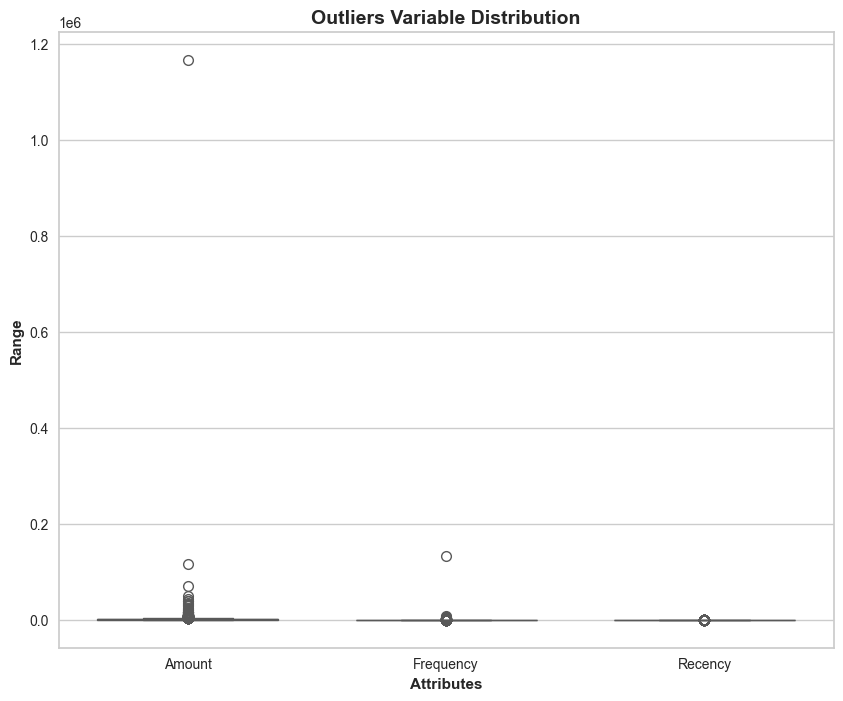

In [84]:
# Outlier Analysis of Amount Frequency and Recency

attributes = ['Amount','Frequency','Recency']
plt.rcParams['figure.figsize'] = [10,8]
sns.boxplot(data = rfm[attributes], orient="v", palette="Set2" ,whis=1.5,saturation=1, width=0.7)

plt.title("Outliers Variable Distribution", fontsize = 14, fontweight = 'bold')
plt.ylabel("Range", fontweight = 'bold')
plt.xlabel("Attributes", fontweight = 'bold');

In [85]:
# Removing (statistical) outliers for Amount
Q1 = rfm.Amount.quantile(0.05)
Q3 = rfm.Amount.quantile(0.95)
IQR = Q3 - Q1
rfm = rfm[(rfm.Amount >= Q1 - 1.5*IQR) & (rfm.Amount <= Q3 + 1.5*IQR)]

# Removing (statistical) outliers for Recency
Q1 = rfm.Recency.quantile(0.05)
Q3 = rfm.Recency.quantile(0.95)
IQR = Q3 - Q1
rfm = rfm[(rfm.Recency >= Q1 - 1.5*IQR) & (rfm.Recency <= Q3 + 1.5*IQR)]

# Removing (statistical) outliers for Frequency
Q1 = rfm.Frequency.quantile(0.05)
Q3 = rfm.Frequency.quantile(0.95)
IQR = Q3 - Q1
rfm = rfm[(rfm.Frequency >= Q1 - 1.5*IQR) & (rfm.Frequency <= Q3 + 1.5*IQR)]

## <font color='skyblue'> <b>Scaling</b><font color='black'> 

In [87]:
rfm_df = rfm[['Amount', 'Frequency', 'Recency', 'RFM_Score']]

scaler = StandardScaler()

rfm_df_scaled = scaler.fit_transform(rfm_df)

In [88]:
rfm_df_scaled = pd.DataFrame(rfm_df_scaled)
rfm_df_scaled.columns = ['Amount', 'Frequency', 'Recency', 'RFM_Score']
rfm_df_scaled.head()

,Amount,Frequency,Recency,RFM_Score
0,-0.703638,-0.757819,2.309462,-1.444945
1,1.779464,1.046899,-0.901666,1.484455
2,-0.050204,-0.467059,-0.178171,0.507989
3,0.209508,-0.045958,-0.733181,0.996222
4,-0.528638,-0.607426,2.150888,-1.444945


## <font color='skyblue'> <b>Kmeans Model</b><font color='black'> 

In [90]:
kmeans_model = KMeans(max_iter=50, random_state=42)  # default n_clusters=8
kmeans_model.fit(rfm_df_scaled)

KMeans(max_iter=50, random_state=42)

In [91]:
kmeans_model.labels_

array([3, 4, 5, ..., 5, 6, 2])

## <font color='skyblue'> <b>Hopkins Test</b><font color='black'> 

In [93]:
from sklearn.neighbors import BallTree

def hopkins(data_frame, sampling_size):
    
    """Assess the clusterability of a dataset. A score between 0 and 1, a score around 0.5 express
    no clusterability and a score tending to 0 express a high cluster tendency.
    Parameters
    ----------
    data_frame : numpy array
        The input dataset
    sampling_size : int
        The sampling size which is used to evaluate the number of DataFrame.
    Returns
    ---------------------
    score : float
        The hopkins score of the dataset (between 0 and 1)
    Examples
    --------
    >>> from sklearn import datasets
    >>> from pyclustertend import hopkins
    >>> X = datasets.load_iris().data
    >>> hopkins(X,150)
    0.16
    """
    
    if type(data_frame) == np.ndarray:
        data_frame = pd.DataFrame(data_frame)
    
    # Sample n observations from D : P
    if sampling_size > data_frame.shape[0]:
        raise Exception(
            'The number of sample of sample is bigger than the shape of D')
    data_frame_sample = data_frame.sample(n=sampling_size)
    
    # Get the distance to their neirest neighbors in D : X
    tree = BallTree(data_frame, leaf_size=2)
    dist, _ = tree.query(data_frame_sample, k=2)
    data_frame_sample_distances_to_nearest_neighbours = dist[:, 1]
    
    # Randomly simulate n points with the same variation as in D : Q.
    max_data_frame = data_frame.max()
    min_data_frame = data_frame.min()
    uniformly_selected_values_0 = np.random.uniform(min_data_frame[0], max_data_frame[0], sampling_size)
    uniformly_selected_values_1 = np.random.uniform(min_data_frame[1], max_data_frame[1], sampling_size)
    uniformly_selected_observations = np.column_stack((uniformly_selected_values_0, uniformly_selected_values_1))
    if len(max_data_frame) >= 2:
        for i in range(2, len(max_data_frame)):
            uniformly_selected_values_i = np.random.uniform(min_data_frame[i], max_data_frame[i], sampling_size)
            to_stack = (uniformly_selected_observations, uniformly_selected_values_i)
            uniformly_selected_observations = np.column_stack(to_stack)
    uniformly_selected_observations_df = pd.DataFrame(uniformly_selected_observations)
    
    # Get the distance to their neirest neighbors in D : Y
    tree = BallTree(data_frame, leaf_size=2)
    dist, _ = tree.query(uniformly_selected_observations_df, k=1)
    uniformly_df_distances_to_nearest_neighbours = dist
    
    # return the hopkins score
    x = sum(data_frame_sample_distances_to_nearest_neighbours)
    y = sum(uniformly_df_distances_to_nearest_neighbours)
    if x + y == 0:
        raise Exception('The denominator of the hopkins statistics is null')
    return x / (x + y)[0]

In [94]:
# It's good if the result is below 0.3.
hopkins(rfm_df_scaled, rfm_df_scaled.shape[0])

0.037015259185249866

## <font color='skyblue'> <b>Elbow Method for Choosing The Optimum K Value</b><font color='black'> 

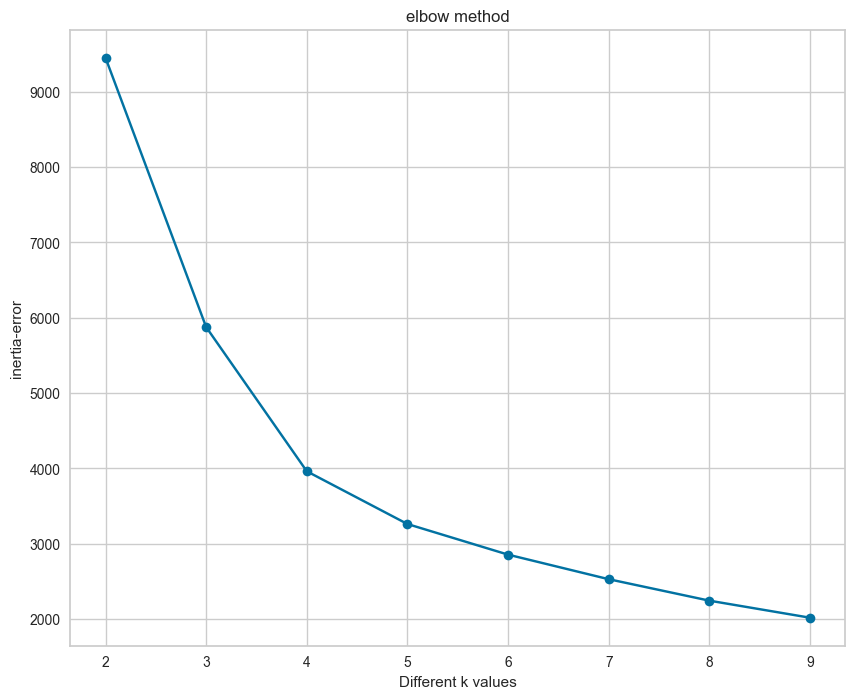

In [96]:
ssd = []    # inertia  .. SSD, "Sum of Squared Distances"

K = range(2,10)

for k in K:
    model = KMeans(n_clusters =k, random_state=42)
    model.fit(rfm_df_scaled)
    ssd.append(model.inertia_)

plt.plot(K, ssd, "bo-")
plt.xlabel("Different k values")
plt.ylabel("inertia-error")
plt.title("elbow method")
plt.show()

In [97]:
df_diff =pd.DataFrame(-pd.Series(ssd).diff()).rename(index = lambda x : x+1)
df_diff

,0
1,NaN
2,3576.112691
3,1914.433041
4,700.193713
5,406.426640
6,326.131068
7,284.863661
8,226.384173


If we look at the inertia error, it is observed that the sharp decrease ends at 4. For now, k=4 can be accepted. But we also need to look at the silhouette score.

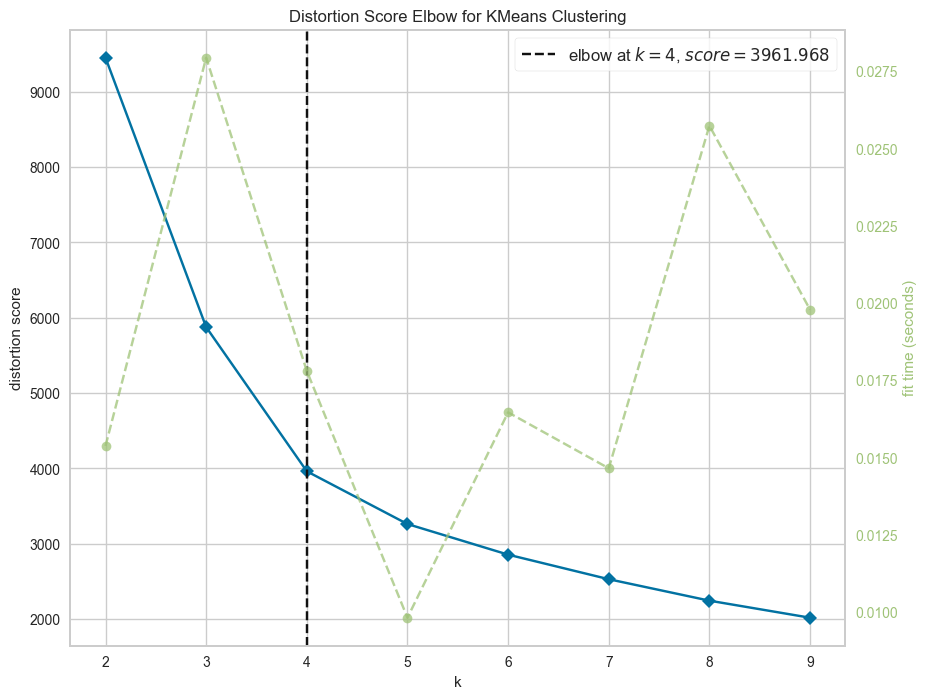

In [99]:
# Elbow method with yellowbrick

from yellowbrick.cluster import KElbowVisualizer

model_ = KMeans(random_state=42)

visualizer = KElbowVisualizer(model_, k=(2,10))

visualizer.fit(rfm_df_scaled)
visualizer.show();

## <font color='skyblue'> <b>Silhouette Analysis</b><font color='black'> 

In [101]:
# for the first model that created with default n_clusters=8
from sklearn.metrics import silhouette_score
silhouette_score(rfm_df_scaled, kmeans_model.labels_)

0.3770502591861856

The silhouette score should be close to 0.50. This score of the model with the default values looks good but let's look other clusters' scores too.

In [103]:
range_n_clusters = range(2,10)

for num_clusters in range_n_clusters:
    
    # intialise kmeans
    kmeans = KMeans(n_clusters=num_clusters, random_state=42)
    kmeans.fit(rfm_df_scaled)
    cluster_labels = kmeans.labels_
    
    # silhouette score
    silhouette_avg = silhouette_score(rfm_df_scaled, cluster_labels)
    print(f"For n_clusters={num_clusters}, the silhouette score is {silhouette_avg}")

For n_clusters=2, the silhouette score is 0.4484443632444598
For n_clusters=3, the silhouette score is 0.4424812084311119
For n_clusters=4, the silhouette score is 0.43771079117983935
For n_clusters=5, the silhouette score is 0.3854652072610649
For n_clusters=6, the silhouette score is 0.37999872896226045
For n_clusters=7, the silhouette score is 0.35406789765047714
For n_clusters=8, the silhouette score is 0.3770502591861856
For n_clusters=9, the silhouette score is 0.3605295544685118


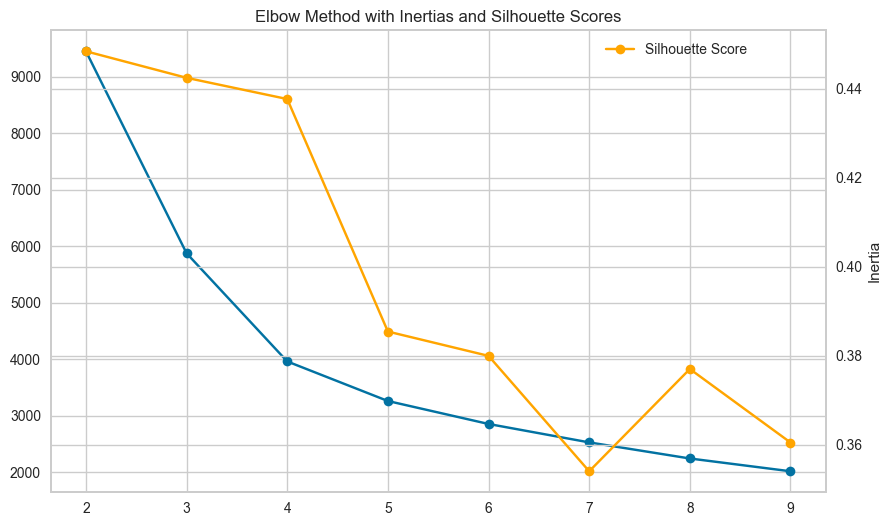

In [104]:
# Graph showing Elbow and Silhouette scores together

inertia_scores = []
silhouette_scores = []
for i in range(2, 10):
    model = KMeans(n_clusters=i, random_state=42)
    labels = model.fit_predict(rfm_df_scaled)
    silhouette = silhouette_score(rfm_df_scaled, labels)
    inertia = model.inertia_
    inertia_scores.append(inertia)
    silhouette_scores.append(silhouette)

# Plotting the Elbow Method with Inertias and Silhouette Scores
plt.figure(figsize=(10, 6))

# Plot Inertias
plt.plot(range(2,10), inertia_scores, label='Inertia', marker='o')

# Plot Silhouette Scores on a secondary y-axis
plt.twinx()
plt.plot(range(2,10), silhouette_scores, label='Silhouette Score', marker='o', color='orange')

# Add labels, title, and legend
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method with Inertias and Silhouette Scores')
plt.legend(loc='upper left', bbox_to_anchor=(0.7, 1))
plt.show()

**As a result of the studies, it was decided that the k value should be 4 according to the inertia error and silhouette score.**

## <font color='skyblue'> <b>Silhouette Visualizer</b><font color='black'> 

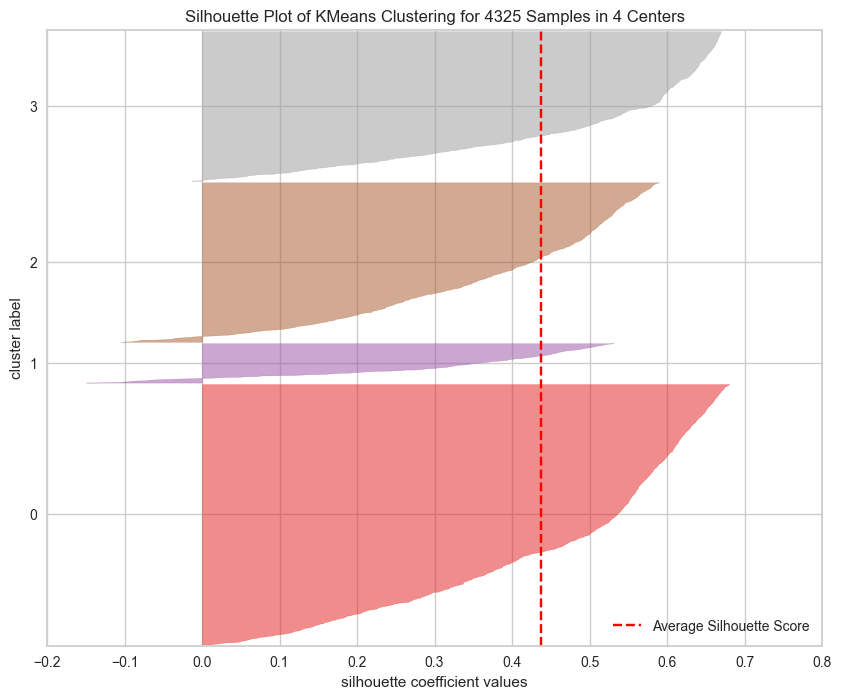

In [107]:
from sklearn.cluster import KMeans

from yellowbrick.cluster import SilhouetteVisualizer

kmeans4 = KMeans(n_clusters=4, random_state=42)  # n_clusters= 4 was selected and drawing was made accordingly.
visualizer = SilhouetteVisualizer(kmeans4)

visualizer.fit(rfm_df_scaled)
visualizer.poof();

## <font color='skyblue'> <b>Building The Model Based On The Optimal Number of Clusters</b><font color='black'> 

In [109]:
model = KMeans(n_clusters=4, random_state=42)
model.fit_predict(rfm_df_scaled)

array([3, 2, 0, ..., 0, 1, 2])

In [110]:
clusters = model.labels_

In [111]:
rfm["predicted_clusters"] = clusters

In [112]:
rfm.sample(10)

,CustomerID,Amount,Frequency,Recency,R,F,M,RFM_Segment,RFM_Score,Robust RFM Level,predicted_clusters
3794,17505.0,1103.04,52,161,1,2,3,123,6,Silver,0
2352,15527.0,2124.53,165,18,3,3,3,333,9,Gold,2
2655,15938.0,369.78,18,111,1,1,2,112,4,Bronze,0
2313,15473.0,537.60,14,13,3,1,2,312,6,Silver,0
4037,17836.0,110.21,24,46,2,1,1,211,4,Bronze,0
1316,14117.0,90.00,3,143,1,1,1,111,3,Bronze,3
2505,15728.0,100.95,4,48,2,1,1,211,4,Bronze,0
662,13216.0,164.10,5,267,1,1,1,111,3,Bronze,3
306,12718.0,238.25,19,70,2,1,1,211,4,Bronze,0
1171,13924.0,1995.62,137,1,3,3,3,333,9,Gold,2


In [113]:
rfm.groupby('predicted_clusters')['RFM_Score'].mean()

predicted_clusters
0    5.450514
1    8.800000
2    8.255075
3    3.650047
Name: RFM_Score, dtype: float64

In [114]:
pd.crosstab(rfm.predicted_clusters, rfm["Robust RFM Level"])

Robust RFM Level,Bronze,Gold,Silver
predicted_clusters,,,
0,901,0,948
1,0,276,4
2,0,979,154
3,1023,0,40


In [115]:
rfm['predicted_clusters']=rfm['predicted_clusters'].map({0: 'K_Silver', 1: 'K_VIP',2:'K_Gold', 3:'K_Bronze'})

In [116]:
rfm.sample(5)

,CustomerID,Amount,Frequency,Recency,R,F,M,RFM_Segment,RFM_Score,Robust RFM Level,predicted_clusters
3682,17354.0,493.34,16,50,2,1,2,212,5,Bronze,K_Silver
2856,16207.0,367.78,19,24,2,1,2,212,5,Bronze,K_Silver
4164,18005.0,226.47,53,3,3,2,1,321,6,Silver,K_Silver
2295,15450.0,429.84,30,29,2,2,2,222,6,Silver,K_Silver
1027,13723.0,179.70,6,216,1,1,1,111,3,Bronze,K_Bronze


<a id='cohort'></a>
# <font color='steelblue'> <b>Cohort Analysis</b><font color='black'> 

**Cohort Analysis**

Cohort analysis is a method used to examine the behavior of users grouped based on specific time periods or behavioral characteristics. It is particularly useful for analyzing customer retention rates and understanding how user behavior changes over time.

**What is a Cohort?**

A cohort is a group of people or customers who share a common characteristic. For example:
- **Registration date**: Users who signed up within a specific month.
- **First purchase date**: Customers who made their first purchase within a specific period.

---

**Objectives of Cohort Analysis:**
1. Analyze customer retention rates.
2. Understand trends in customer behavior.
3. Measure the effectiveness of marketing strategies.
4. Observe how customer groups evolve over time.

---

**How is it Done?**
Cohort analysis is usually based on the first purchase or registration date of customers. The key steps are:

1. **Defining the Cohort**: Identify the customer groups to be included in the analysis. For example, grouping customers based on their registration date by month.

2. **Tracking Customer Behavior**: Monitor the behavior of each cohort over time (e.g., purchase frequency, repeat purchase rate).

3. **Analyzing Trends**: Evaluate how behaviors and performance change over time for each cohort. This focuses on customer lifecycle and post-interaction behavior.

4. **Segmentation and Comparison**: Analyze the obtained data and compare different cohort groups. This is important for understanding how specific marketing strategies or business changes affect cohort behaviors.

---

**Use Cases of Cohort Analysis:**
- **E-commerce:** Measure customer loyalty and purchasing trends.
- **SaaS Companies:** Analyze churn rates.
- **Mobile Applications:** Track user retention rates.

---

**Benefits of Cohort Analysis:**
- **Understanding Customer Behavior:** Helps identify which customer groups are the most valuable and how they behave.  
- **Optimizing Marketing Strategies:** Useful for evaluating and optimizing the impact of marketing strategies.  
- **Customer Loyalty and Relationship Management:** Helps understand how customer loyalty evolves over time.  

---

**Example Analysis Questions:**
- How long do new customers stay engaged after their first purchase?  
- How did a marketing campaign affect customers from a specific period?  
- Is the customer retention rate increasing or decreasing over time?  

---

**Differences Between RFM Analysis and Cohort Analysis**

| **RFM Analysis**                          | **Cohort Analysis**                      |
|--------------------------------------------|------------------------------------------|
| Evaluates customers based on individual scores. | Examines customers in groups.           |
| Primarily used for customer segmentation.  | Suitable for analyzing customer behavior. |
| Focuses on assessing past and current customer behavior. | Focuses on analyzing trends over time.  |

In [119]:
import datetime as dt

def get_month(x): return dt.datetime(x.year, x.month, 1)
df['InvoiceMonth'] = df['InvoiceDate'].apply(get_month)
grouping = df.groupby('CustomerID')['InvoiceMonth']
df['CohortMonth'] = grouping.transform('min')

In [120]:
def get_date_int(df, column):
    year = df[column].dt.year
    month = df[column].dt.month
    day = df[column].dt.day
    return year, month, day

In [121]:
invoice_year, invoice_month, invoice_day = get_date_int(df, 'InvoiceMonth')
cohort_year, cohort_month, cohort_day = get_date_int(df, 'CohortMonth')

years_diff = invoice_year - cohort_year
months_diff = invoice_month - cohort_month

df['CohortIndex'] = years_diff * 12 + months_diff + 1

df.tail()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,TotalAmount,DateDiff,InvoiceMonth,CohortMonth,CohortIndex
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680.0,France,10.20,0 days,2011-12-01,2011-08-01,5
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680.0,France,12.60,0 days,2011-12-01,2011-08-01,5
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680.0,France,16.60,0 days,2011-12-01,2011-08-01,5
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680.0,France,16.60,0 days,2011-12-01,2011-08-01,5
541908,581587,22138,BAKING SET 9 PIECE RETROSPOT,3,2011-12-09 12:50:00,4.95,12680.0,France,14.85,0 days,2011-12-01,2011-08-01,5


In [122]:
grouping = df.groupby(['CohortMonth', 'CohortIndex'])

cohort_data = grouping['CustomerID'].apply(pd.Series.nunique)

cohort_data = cohort_data.reset_index()

cohort_counts = cohort_data.pivot(index='CohortMonth',
                                 columns='CohortIndex',
                                 values='CustomerID')

In [123]:
cohort_sizes = cohort_counts.iloc[:,0]
retention = cohort_counts.divide(cohort_sizes, axis=0)
retention.index=retention.index.date

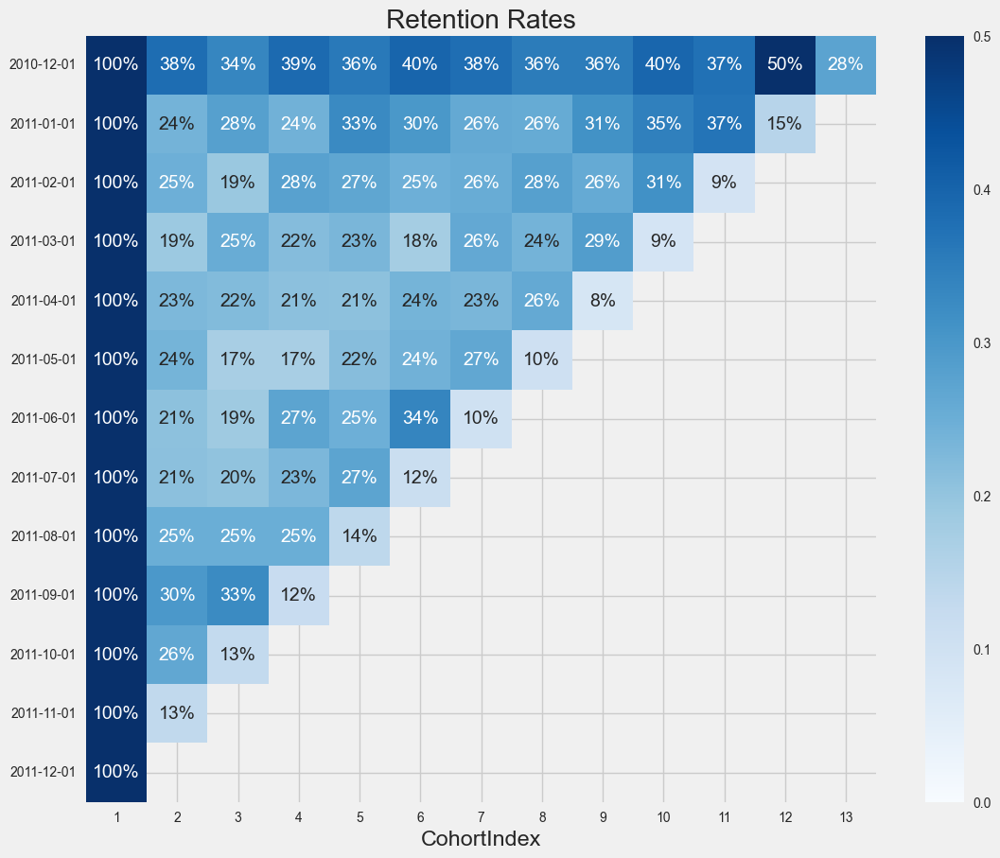

In [199]:
plt.style.use('fivethirtyeight')
plt.figure(figsize=(12,10))
plt.title('Retention Rates')

sns.heatmap(data = retention,
           annot = True,
           fmt = '.0%',
           vmin= 0.0,
           vmax=0.5,
           cmap='Blues')
plt.show()

**General Insights**

- **1st column (CohortIndex = 1)**: Each row starts at 100% because it represents the first month when users joined or made their first transaction.
- **Decreasing percentages**: As the cohort progresses (moving right), the percentages decrease. This shows that users lose activity or churn over time.
- **Vertical comparison**: You can compare how different cohorts performed in the same months. For instance:
  - **2011-01-01 cohort** has a 28% retention in the second month.
  - **2011-02-01 cohort** has a 25% retention in the second month.

---

**Notable Observations**

- **High-performing cohorts**: The 2010-12-01 cohort stands out with a **40% retention in the 6th month**, which is higher than most other cohorts. This indicates a particularly loyal group.
- **General trend**: Most cohorts experience a significant drop in retention after the 3rd or 4th month. This indicates that many users stop engaging after this period.
- **Low-performing cohorts**: For example, the 2011-11-01 cohort shows a sharp decline, with retention dropping to **13%**.

---

**Business Strategy Recommendations**

- **Increase retention**: Since there is a noticeable drop in the 3rd-4th months, implementing strategies like special offers, campaigns, or follow-up reminders during these periods could help retain users.
- **Analyze successful cohorts**: Investigate why the 2010-12-01 cohort performed better than others. Perhaps a successful campaign or improved service quality was implemented during that period.
- **Focus on low-performing cohorts**: Examine cohorts like 2011-11-01 to identify potential issues. For example, problems might include weak user acquisition strategies or product/service-related issues.

<a id='conclusion'></a>
# <font color='steelblue'> <b>Conclusion</b><font color='black'> 

In this project, customer segmentation was performed using **RFM analysis and clustering techniques**. Customers were categorized into **Bronze, Silver, Gold, and VIP** segments, and distinct behavioral patterns were observed in each segment.  

The clustering results provide valuable insights for the development of marketing strategies tailored to different customer groups. For instance, **VIP customers**, identified as high-spending and frequent buyers, should be retained through exclusive campaigns and loyalty programs. On the other hand, **Bronze customers** could be encouraged to become more active through targeted promotions or discounts.  

Through this study, customer data can be leveraged more effectively to enhance business profitability. Future research could focus on predictive modeling techniques to forecast customer behavior and develop personalized recommendation systems.  

<p style="background-color:steelblue;font-family:newtimeroman;font-size:200%;color:white;text-align:center;border-radius:60px 20px;"><b>THANK YOU!</b></p>